# Hierarchical Clustering

### Data Mining Project 2024/25

Authors: Nicola Emmolo, Simone Marzeddu, Jacopo Raffi

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import pandas as pd
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
from scipy.spatial.distance import pdist
from scipy.cluster.hierarchy import linkage, dendrogram, cophenet
from sklearn.preprocessing import StandardScaler

import seaborn as sns
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.cluster import AgglomerativeClustering
import numpy as np
from scipy.cluster.hierarchy import fcluster

import itertools

import warnings
warnings.filterwarnings('ignore')

In [3]:
def plot_variable_pairs(columns_to_use, dataset):
    # Creazione di tutte le combinazioni di coppie di variabili
    pairs = list(itertools.combinations(columns_to_use, 2))
    n_pairs = len(pairs)

    # Dimensione della griglia (calcolata in base al numero di coppie)
    n_cols = 2  # Numero di colonne nella griglia
    n_rows = int(np.ceil(n_pairs / n_cols))  # Numero di righe nella griglia

    # Creazione della griglia di subplot
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(10, 5 * n_rows))

    # Se c'è una sola riga di subplot, axes sarà un array 1D; uniformiamo la struttura.
    if n_rows == 1:
        axes = axes[np.newaxis, :]

    # Plot per ogni coppia di variabili
    for (x_var, y_var), ax in zip(pairs, axes.ravel()):
        sns.scatterplot(
            data=dataset,
            x=x_var, y=y_var, hue="cluster", palette="viridis", ax=ax, s=10
        )
        ax.set_title(f'Clusters: {x_var} vs {y_var}')
        ax.legend()

    # Rimuovi subplot vuoti se n_pairs non riempie la griglia
    for ax in axes.ravel()[n_pairs:]:
        fig.delaxes(ax)

    plt.tight_layout()
    plt.show()

In [4]:
def plot_variable_triplets(columns_to_use, dataset):
    # Creazione di tutte le combinazioni di triplette di variabili
    triplets = list(itertools.combinations(columns_to_use, 3))
    n_triplets = len(triplets)

    # Dimensione della griglia (calcolata in base al numero di triplette)
    n_cols = 2  # Numero di colonne nella griglia
    n_rows = int(np.ceil(n_triplets / n_cols))  # Numero di righe nella griglia

    # Creazione della griglia di subplot
    fig = plt.figure(figsize=(14, 7 * n_rows))


    # Plot per ogni combinazione di tre variabili
    for i, (x_var, y_var, z_var) in enumerate(triplets):
        ax = fig.add_subplot(n_rows, n_cols, i + 1, projection='3d')

        # Scatterplot dei dati
        ax.scatter(
            dataset[x_var],
            dataset[y_var],
            dataset[z_var],
            c=dataset["cluster"], cmap="viridis", s=10, zorder=1
        )

        # Titolo e etichette
        ax.set_title(f'Clusters: {x_var} vs {y_var} vs {z_var}', pad=20)
        ax.set_xlabel(x_var)
        ax.set_ylabel(y_var)
        ax.set_zlabel(z_var)

    # Imposta layout per evitare sovrapposizioni
    plt.tight_layout()
    plt.show()

In [5]:
cyclists_dataset = pd.read_csv('../../data/cyclists_dataset_no_outliers.csv')
cyclists_dataset = cyclists_dataset.select_dtypes(include=['number'])
cyclists_dataset = cyclists_dataset.dropna().reset_index(drop=True)

cyclists_dataset.info()
columns_to_use = cyclists_dataset.columns

# Standardizzazione dei dati
scaler = StandardScaler()
data_scaled = scaler.fit_transform(cyclists_dataset)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2778 entries, 0 to 2777
Data columns (total 7 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   mean_cyclist_cp  2778 non-null   float64
 1   mean_delta       2778 non-null   float64
 2   mean_position    2778 non-null   float64
 3   birth_year       2778 non-null   int64  
 4   weight           2778 non-null   float64
 5   height           2778 non-null   float64
 6   cyclist_bmi      2778 non-null   float64
dtypes: float64(6), int64(1)
memory usage: 152.0 KB


## Complete

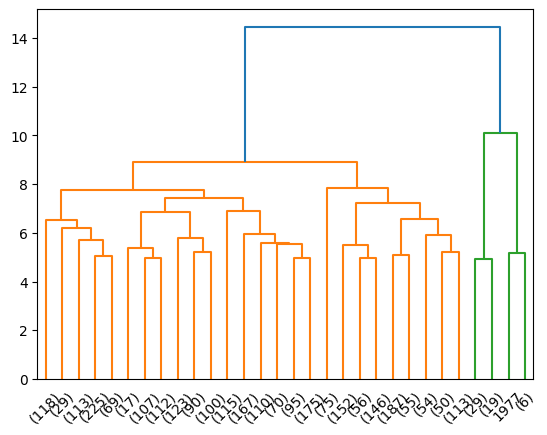

In [6]:
data_dist = pdist(data_scaled, metric='euclidean')
data_link = linkage(data_dist, method='complete', metric='euclidean')
res = dendrogram(data_link, truncate_mode='lastp')

In [7]:
c, _ = cophenet(data_link, data_dist)
c

np.float64(0.5429037961168254)

In [8]:
cluster_labels = fcluster(data_link, t=12, criterion='distance')
silhouette_score(data_scaled, cluster_labels)

np.float64(0.45363366703101254)

### 2D

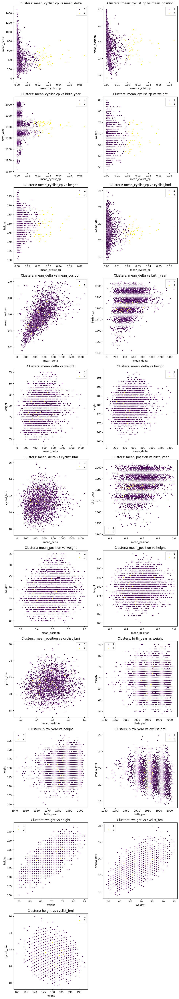

In [9]:
cyclists_dataset['cluster'] = cluster_labels
plot_variable_pairs(columns_to_use, cyclists_dataset)

### 3D

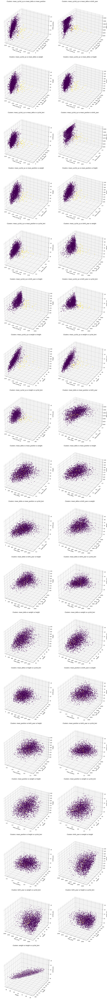

In [10]:
cyclists_dataset['cluster'] = cluster_labels
plot_variable_triplets(columns_to_use, cyclists_dataset)

## Single

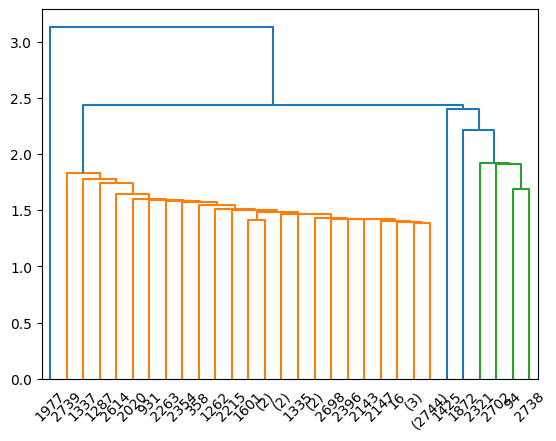

In [11]:
data_dist = pdist(data_scaled, metric='euclidean')
data_link = linkage(data_dist, method='single', metric='euclidean')
res = dendrogram(data_link, truncate_mode='lastp')

In [12]:
c, _ = cophenet(data_link, data_dist)
c

np.float64(0.5807569033701178)

In [13]:
cluster_labels = fcluster(data_link, t=2.5, criterion='distance')
silhouette_score(data_scaled, cluster_labels)

np.float64(0.7300347044389773)

### 2D

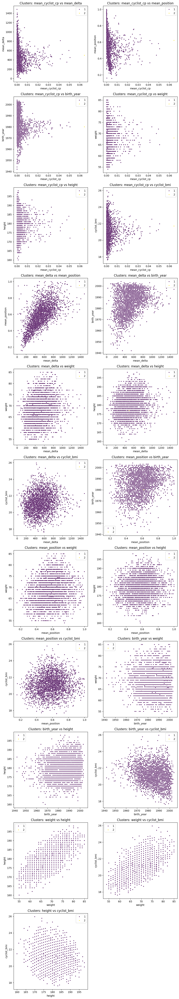

In [14]:
cyclists_dataset['cluster'] = cluster_labels
plot_variable_pairs(columns_to_use, cyclists_dataset)

### 3D

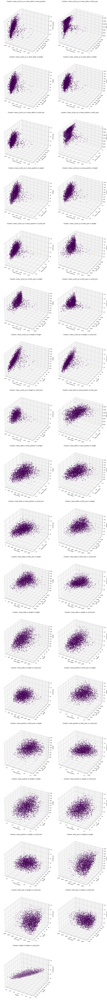

In [15]:
cyclists_dataset['cluster'] = cluster_labels
plot_variable_triplets(columns_to_use, cyclists_dataset)

## Average

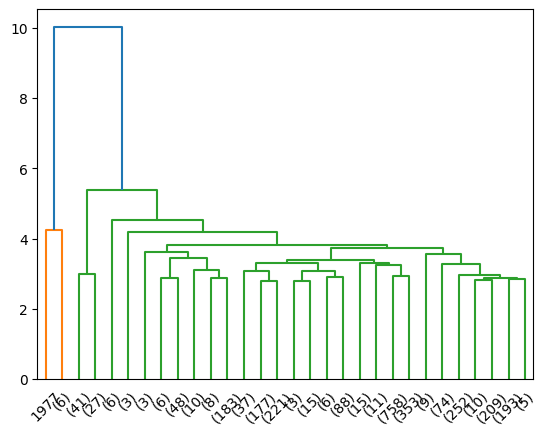

In [16]:
data_dist = pdist(data_scaled, metric='euclidean')
data_link = linkage(data_dist, method='average', metric='euclidean')
res = dendrogram(data_link, truncate_mode='lastp')

In [17]:
c, _ = cophenet(data_link, data_dist)
c

np.float64(0.6309589509412875)

In [18]:
cluster_labels = fcluster(data_link, t=5, criterion='distance')
silhouette_score(data_scaled, cluster_labels)

np.float64(0.36867005621188526)

### 2D

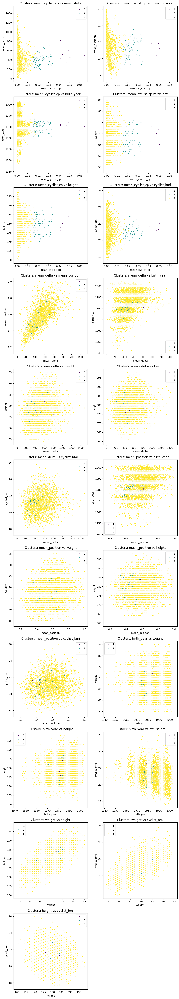

In [19]:
cyclists_dataset['cluster'] = cluster_labels
plot_variable_pairs(columns_to_use, cyclists_dataset)

### 3D

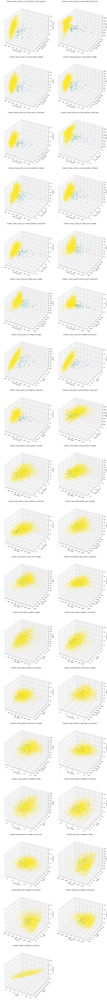

In [20]:
cyclists_dataset['cluster'] = cluster_labels
plot_variable_triplets(columns_to_use, cyclists_dataset)

## Ward

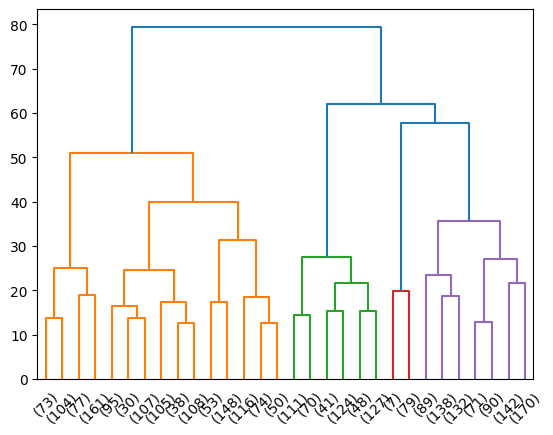

In [21]:
data_dist = pdist(data_scaled, metric='euclidean')
data_link = linkage(data_dist, method='ward', metric='euclidean')
res = dendrogram(data_link, truncate_mode='lastp')

In [22]:
c, _ = cophenet(data_link, data_dist)
c

np.float64(0.37084501288386984)

In [23]:
cluster_labels = fcluster(data_link, t=60, criterion='distance')
silhouette_score(data_scaled, cluster_labels)

np.float64(0.1369621552232869)

### 2D

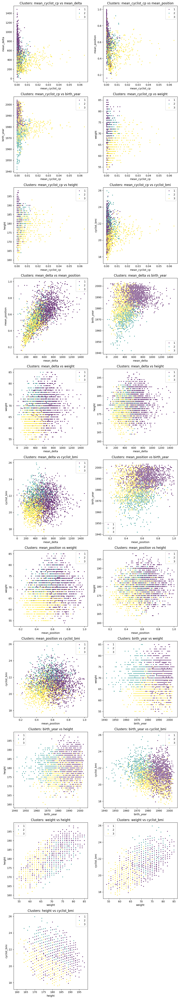

In [24]:
cyclists_dataset['cluster'] = cluster_labels
plot_variable_pairs(columns_to_use, cyclists_dataset)

### 3D

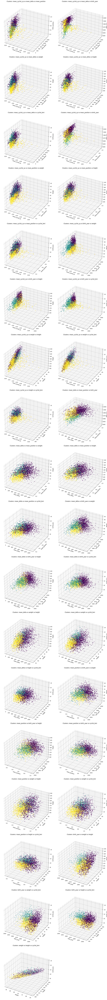

In [25]:
cyclists_dataset['cluster'] = cluster_labels
plot_variable_triplets(columns_to_use, cyclists_dataset)